# SVM and Kernel

# Download and unzip the kaggle data

In [ ]:
!pip install kaggle
!mkdir %userprofile%\.kaggle !move %USERPROFILE%\Downloads\kaggle.json %USERPROFILE%\.kaggle

In [ ]:
import os 
os.listdir('.kaggle')

In [ ]:
!kaggle datasets download -d ionaskel/nba-games-stats-from-2014-to-2018

In [ ]:
import zipfile
with zipfile.ZipFile('./nba-games-stats-from-2014-to-2018.zip', 'r') as zip_ref:
     zip_ref.extractall('./nba.games.stats.csv')

# Data Exploration

In [1]:
import pandas as pd
data = pd.read_csv ('nba.games.stats.csv/nba.games.stats.csv')

In [2]:
data.columns

Index(['Unnamed: 0', 'Team', 'Game', 'Date', 'Home', 'Opponent', 'WINorLOSS',
       'TeamPoints', 'OpponentPoints', 'FieldGoals', 'FieldGoalsAttempted',
       'FieldGoals.', 'X3PointShots', 'X3PointShotsAttempted', 'X3PointShots.',
       'FreeThrows', 'FreeThrowsAttempted', 'FreeThrows.', 'OffRebounds',
       'TotalRebounds', 'Assists', 'Steals', 'Blocks', 'Turnovers',
       'TotalFouls', 'Opp.FieldGoals', 'Opp.FieldGoalsAttempted',
       'Opp.FieldGoals.', 'Opp.3PointShots', 'Opp.3PointShotsAttempted',
       'Opp.3PointShots.', 'Opp.FreeThrows', 'Opp.FreeThrowsAttempted',
       'Opp.FreeThrows.', 'Opp.OffRebounds', 'Opp.TotalRebounds',
       'Opp.Assists', 'Opp.Steals', 'Opp.Blocks', 'Opp.Turnovers',
       'Opp.TotalFouls'],
      dtype='object')

In [3]:
data.shape

(9840, 41)

In [4]:
data.describe()

,Unnamed: 0,Game,TeamPoints,OpponentPoints,FieldGoals,FieldGoalsAttempted,FieldGoals.,X3PointShots,X3PointShotsAttempted,X3PointShots.,...,Opp.FreeThrows,Opp.FreeThrowsAttempted,Opp.FreeThrows.,Opp.OffRebounds,Opp.TotalRebounds,Opp.Assists,Opp.Steals,Opp.Blocks,Opp.Turnovers,Opp.TotalFouls
count,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,...,9840.00000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000,9840.000000
mean,11960.157012,41.500000,103.652337,103.652337,38.602439,84.902439,0.455689,9.126829,25.623679,0.354321,...,17.32063,22.749390,0.762395,10.287602,43.520630,22.546545,7.750508,4.827642,13.638618,20.058537
std,18654.867508,23.670804,12.188043,12.188043,5.029992,7.130043,0.054711,3.598084,7.102501,0.097782,...,6.00262,7.390451,0.104297,3.807120,6.410428,5.122989,2.958886,2.536845,3.869543,4.317611
min,1.000000,1.000000,64.000000,64.000000,19.000000,60.000000,0.271000,0.000000,4.000000,0.000000,...,1.00000,1.000000,0.143000,0.000000,20.000000,6.000000,0.000000,0.000000,2.000000,7.000000
25%,2537.750000,21.000000,95.000000,95.000000,35.000000,80.000000,0.418000,7.000000,21.000000,0.290000,...,13.00000,18.000000,0.696000,8.000000,39.000000,19.000000,6.000000,3.000000,11.000000,17.000000
50%,5141.500000,41.500000,103.000000,103.000000,38.000000,85.000000,0.455000,9.000000,25.000000,0.353000,...,17.00000,22.000000,0.769000,10.000000,43.000000,22.000000,8.000000,5.000000,13.000000,20.000000
75%,7715.250000,62.000000,112.000000,112.000000,42.000000,89.000000,0.494000,11.000000,30.000000,0.419000,...,21.00000,27.000000,0.833000,13.000000,48.000000,26.000000,10.000000,6.000000,16.000000,23.000000
max,82119.000000,82.000000,149.000000,149.000000,58.000000,129.000000,0.684000,25.000000,61.000000,0.750000,...,44.00000,64.000000,1.000000,38.000000,81.000000,47.000000,21.000000,18.000000,29.000000,42.000000


# Data Preproccesing

Select the usefull data only

In [5]:
new = data["Team"].isin(["ATL"])
atl_df = data[new]
atl_df.drop(['Team','Unnamed: 0','Game','Date',"FieldGoals.","X3PointShots.","FreeThrows.","Opp.FieldGoals.","Opp.3PointShots.","Opp.FreeThrows."],axis=1,inplace=True)
## Read data and transfer data from characters to digit
from sklearn.preprocessing import LabelBinarizer

lb = LabelBinarizer()

for col in ['Home','Opponent','WINorLOSS']:
    atl_df[col] = lb.fit_transform(atl_df[col])

C:\Users\leech\anaconda3\lib\site-packages\pandas\core\frame.py:3990: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(
<ipython-input-5-3f98f2ac5996>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  atl_df[col] = lb.fit_transform(atl_df[col])
<ipython-input-5-3f98f2ac5996>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vie

Data Scaling

In [6]:
import warnings
warnings.filterwarnings('ignore', module='sklearn')

from sklearn.preprocessing import MinMaxScaler

msc = MinMaxScaler()

atl_df = pd.DataFrame(msc.fit_transform(atl_df),  # this is an np.array, not a dataframe.
                    columns=atl_df.columns)

In [7]:
atl_df.head()

,Home,Opponent,WINorLOSS,TeamPoints,OpponentPoints,FieldGoals,FieldGoalsAttempted,X3PointShots,X3PointShotsAttempted,FreeThrows,...,Opp.3PointShotsAttempted,Opp.FreeThrows,Opp.FreeThrowsAttempted,Opp.OffRebounds,Opp.TotalRebounds,Opp.Assists,Opp.Steals,Opp.Blocks,Opp.Turnovers,Opp.TotalFouls
0,0.0,0.0,0.0,0.459459,0.571429,0.518519,0.290909,0.588235,0.161290,0.222222,...,0.380952,0.793103,0.818182,0.666667,0.526316,0.548387,0.722222,0.600000,0.190476,0.433333
1,1.0,0.0,1.0,0.459459,0.328571,0.333333,0.090909,0.235294,0.096774,0.666667,...,0.523810,0.482759,0.454545,0.428571,0.421053,0.516129,0.277778,0.333333,0.619048,0.566667
2,0.0,0.0,0.0,0.324324,0.357143,0.444444,0.509091,0.294118,0.258065,0.194444,...,0.166667,0.793103,0.969697,0.428571,0.578947,0.516129,0.388889,0.600000,0.666667,0.200000
3,0.0,0.0,0.0,0.689189,0.757143,0.629630,0.527273,0.588235,0.516129,0.527778,...,0.261905,0.551724,0.636364,0.428571,0.605263,0.709677,0.333333,0.466667,0.666667,0.700000
4,1.0,0.0,1.0,0.472973,0.385714,0.259259,0.309091,0.352941,0.161290,0.750000,...,0.261905,0.137931,0.151515,0.523810,0.421053,0.548387,0.111111,0.400000,0.476190,0.666667


In [8]:
atl_df.columns

Index(['Home', 'Opponent', 'WINorLOSS', 'TeamPoints', 'OpponentPoints',
       'FieldGoals', 'FieldGoalsAttempted', 'X3PointShots',
       'X3PointShotsAttempted', 'FreeThrows', 'FreeThrowsAttempted',
       'OffRebounds', 'TotalRebounds', 'Assists', 'Steals', 'Blocks',
       'Turnovers', 'TotalFouls', 'Opp.FieldGoals', 'Opp.FieldGoalsAttempted',
       'Opp.3PointShots', 'Opp.3PointShotsAttempted', 'Opp.FreeThrows',
       'Opp.FreeThrowsAttempted', 'Opp.OffRebounds', 'Opp.TotalRebounds',
       'Opp.Assists', 'Opp.Steals', 'Opp.Blocks', 'Opp.Turnovers',
       'Opp.TotalFouls'],
      dtype='object')

In [9]:
atl_df.shape

(328, 31)

Correlations

In [10]:
import numpy as np

y = (atl_df['WINorLOSS'] == 1)
fields = list(atl_df.drop(['WINorLOSS'],axis=1))
correlations = atl_df[fields].corrwith(y)
correlations.sort_values(inplace=True)
correlations

OpponentPoints             -0.536321
Opp.FieldGoals             -0.485497
Opp.3PointShots            -0.333707
Opp.Assists                -0.314530
Opp.TotalRebounds          -0.247338
Opp.Steals                 -0.225742
X3PointShotsAttempted      -0.203921
Turnovers                  -0.202608
Opp.Blocks                 -0.172552
Opp.FreeThrows             -0.090324
Opp.3PointShotsAttempted   -0.081717
Opp.FieldGoalsAttempted    -0.078386
Opp.FreeThrowsAttempted    -0.061098
FieldGoalsAttempted        -0.054779
TotalFouls                 -0.036188
Opponent                    0.016038
OffRebounds                 0.023747
Opp.TotalFouls              0.072093
X3PointShots                0.074385
Opp.OffRebounds             0.079016
FreeThrowsAttempted         0.098984
FreeThrows                  0.117899
Blocks                      0.150868
Opp.Turnovers               0.152593
Home                        0.165006
Steals                      0.193197
TotalRebounds               0.234514
F

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set_context('talk')
sns.set_palette('dark')
sns.set_style('white')

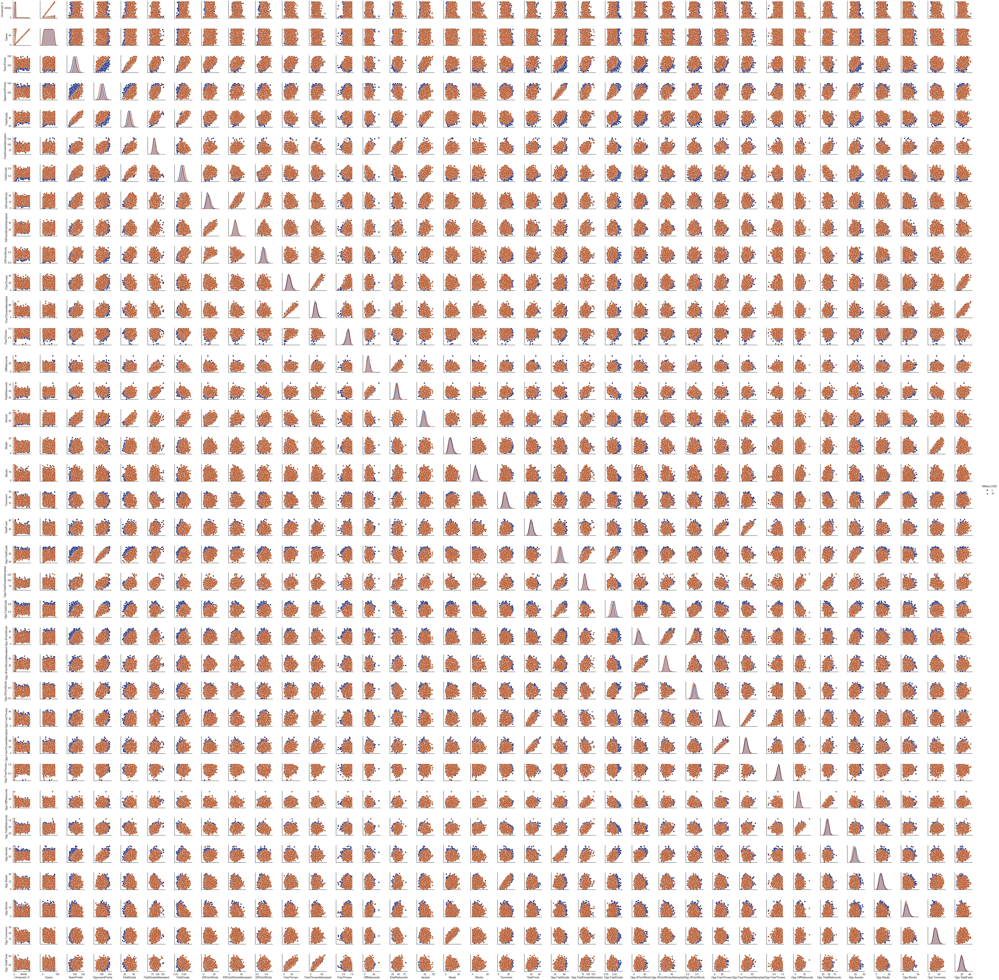

In [12]:
sns.pairplot(data, hue='WINorLOSS')

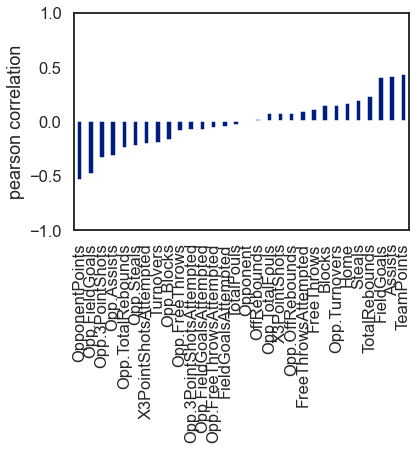

In [13]:
ax = correlations.plot(kind='bar')
ax.set(ylim=[-1, 1], ylabel='pearson correlation');

Data scaling

In [14]:
from sklearn.preprocessing import MinMaxScaler

fields = correlations.map(abs).sort_values().iloc[-4:].index
print(fields)
X = atl_df[fields]
scaler = MinMaxScaler()
X = scaler.fit_transform(X)
X = pd.DataFrame(X, columns=['%s_scaled' % fld for fld in fields])
X.drop(['Opp.FieldGoals_scaled','OpponentPoints_scaled'],axis=1,inplace=True)
print(X.columns)

Index(['Assists', 'TeamPoints', 'Opp.FieldGoals', 'OpponentPoints'], dtype='object')
Index(['Assists_scaled', 'TeamPoints_scaled'], dtype='object')


# Data Visualization with linearSVC

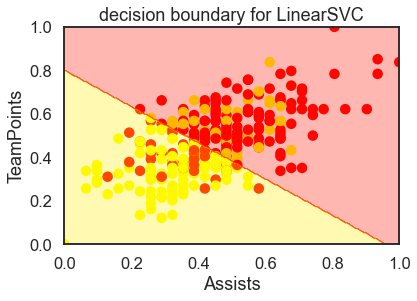

In [15]:
from sklearn.svm import LinearSVC

LSVC = LinearSVC()
LSVC.fit(X, y)

X_color = X.sample(300, random_state=45)
y_color = y.loc[X_color.index]
y_color = y_color.map(lambda r: 'red' if r == 1 else 'yellow')

ax = plt.axes()
ax.scatter(
    X_color.iloc[:, 0], X_color.iloc[:, 1],
    Color=y_color, alpha=1)
# -----------
x_axis, y_axis = np.arange(0, 1.005, .005), np.arange(0, 1.005, .005)
xx, yy = np.meshgrid(x_axis, y_axis)
xx_ravel = xx.ravel()
yy_ravel = yy.ravel()
X_grid = pd.DataFrame([xx_ravel, yy_ravel]).T
y_grid_predictions = LSVC.predict(X_grid)
y_grid_predictions = y_grid_predictions.reshape(xx.shape)
ax.contourf(xx, yy, y_grid_predictions, cmap=plt.cm.autumn_r, alpha=.3)
# -----------
ax.set(
    xlabel=fields[0],
    ylabel=fields[1],
    xlim=[0, 1],
    ylim=[0, 1],
    title='decision boundary for LinearSVC');

# SVC With RBF

In [16]:
def plot_decision_boundary(estimator, X, y):
    estimator.fit(X, y)
    X_color = X.sample(300)
    y_color = y.loc[X_color.index]
    y_color = y_color.map(lambda r: 'red' if r == 1 else 'yellow')
    x_axis, y_axis = np.arange(0, 1, .005), np.arange(0, 1, .005)
    xx, yy = np.meshgrid(x_axis, y_axis)
    xx_ravel = xx.ravel()
    yy_ravel = yy.ravel()
    X_grid = pd.DataFrame([xx_ravel, yy_ravel]).T
    y_grid_predictions = estimator.predict(X_grid)
    y_grid_predictions = y_grid_predictions.reshape(xx.shape)

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.contourf(xx, yy, y_grid_predictions, cmap=plt.cm.autumn_r, alpha=.3)
    ax.scatter(X_color.iloc[:, 0], X_color.iloc[:, 1], color=y_color, alpha=1)
    ax.set(
        xlabel=fields[0],
        ylabel=fields[1],
        title=str(estimator))

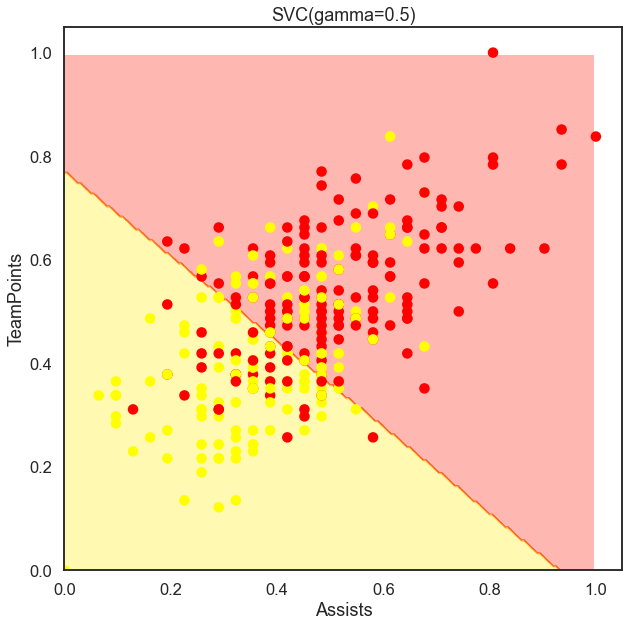

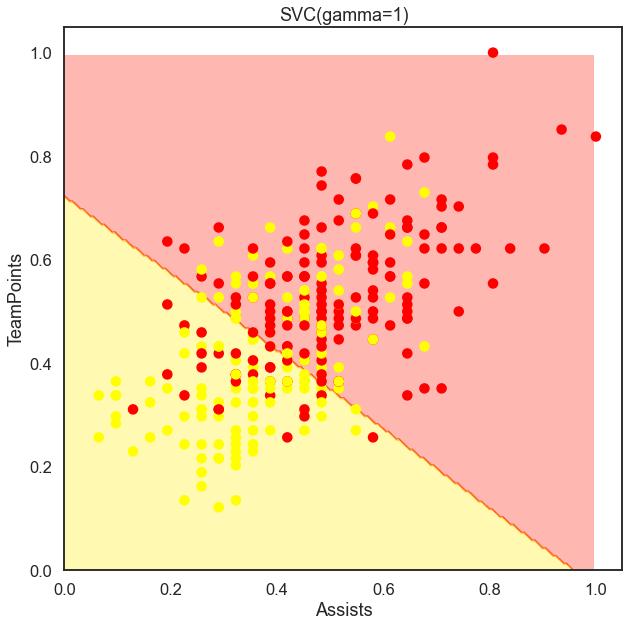

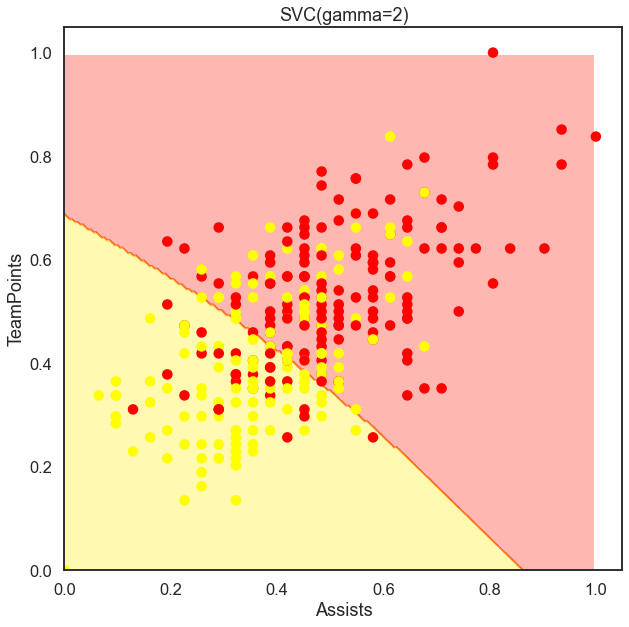

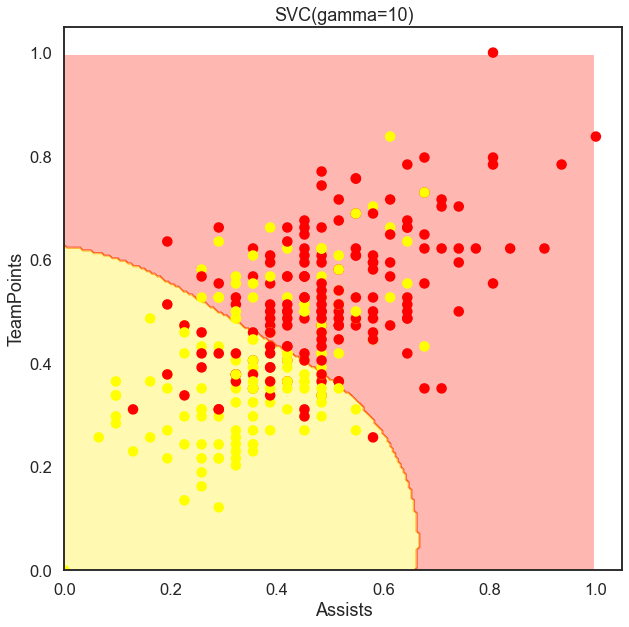

In [17]:
from sklearn.svm import SVC

gammas = [.5, 1, 2, 10]
for gamma in gammas:
    SVC_Gaussian = SVC(kernel='rbf', gamma=gamma)
    plot_decision_boundary(SVC_Gaussian, X, y)

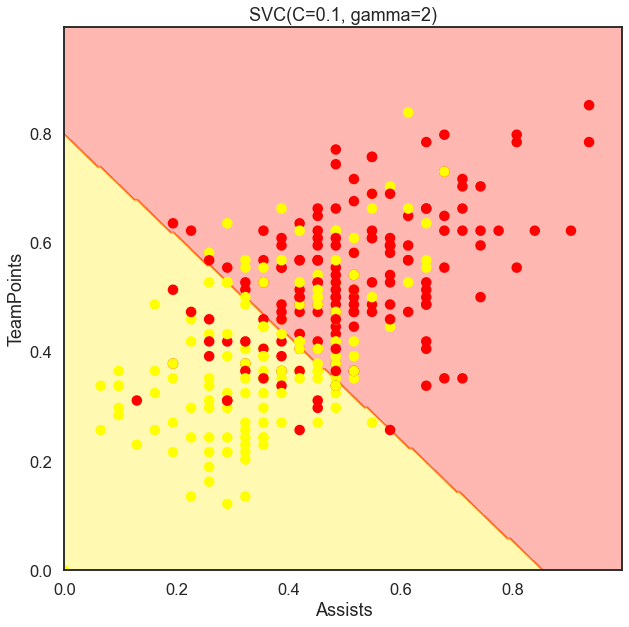

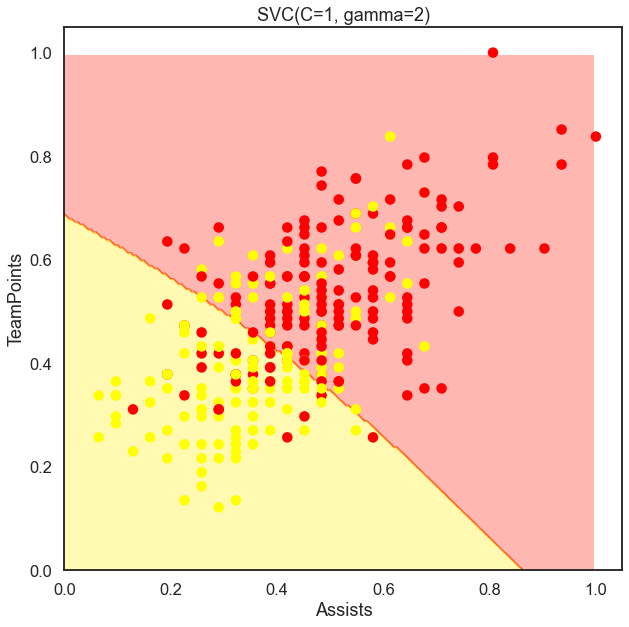

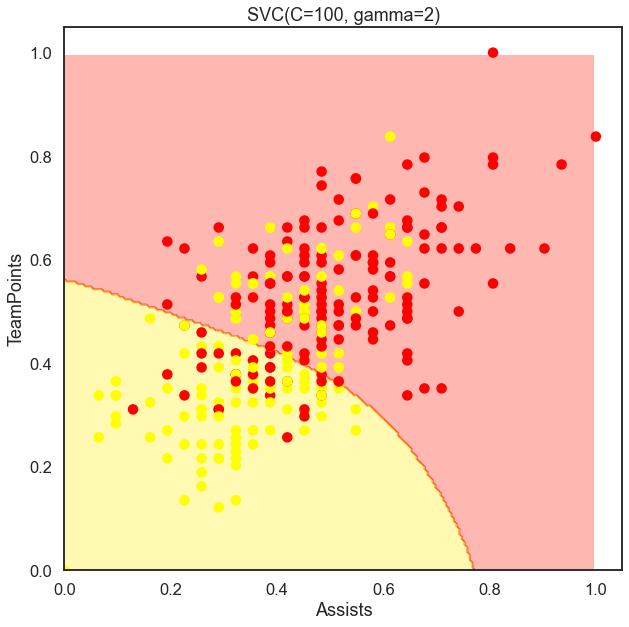

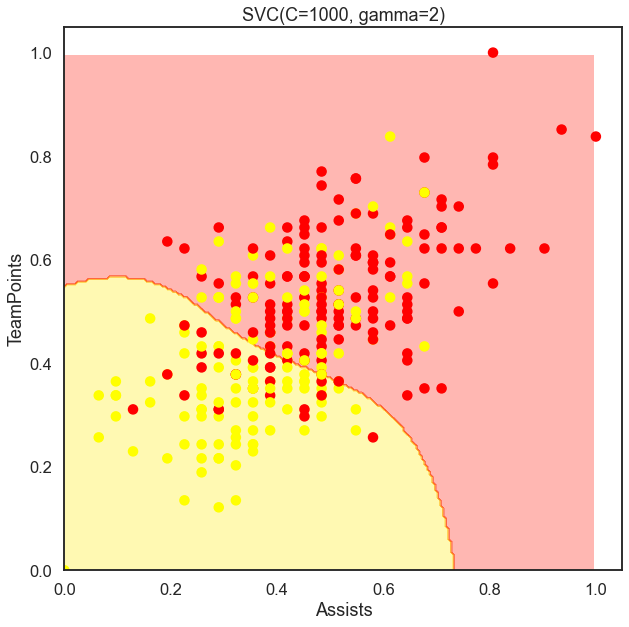

In [18]:
Cs = [.1, 1, 100,1000]
for C in Cs:
    SVC_Gaussian = SVC(kernel='rbf', gamma=2, C=C)
    plot_decision_boundary(SVC_Gaussian, X, y)

# Polynomial kernel SVC with degree 3 

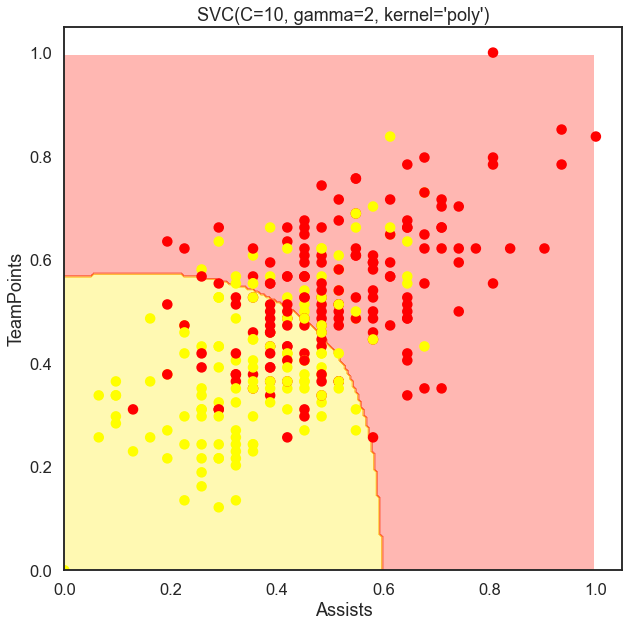

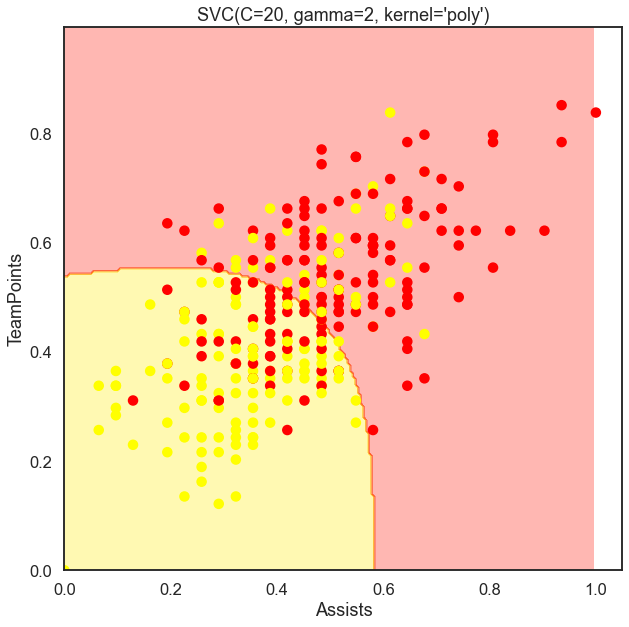

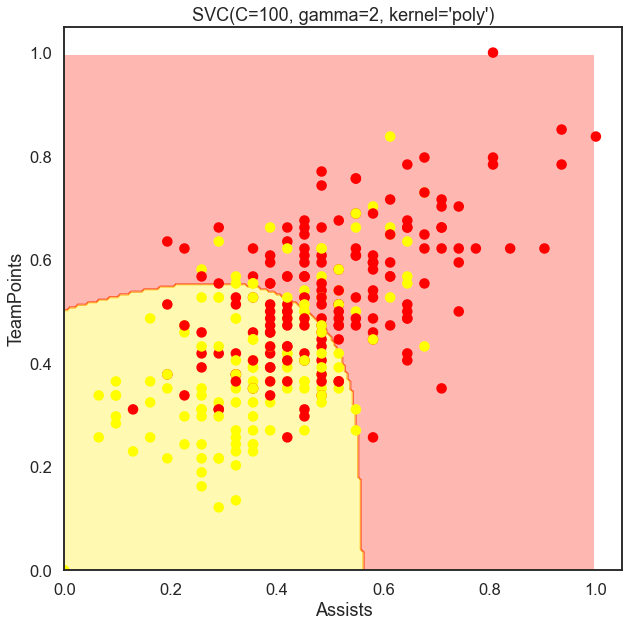

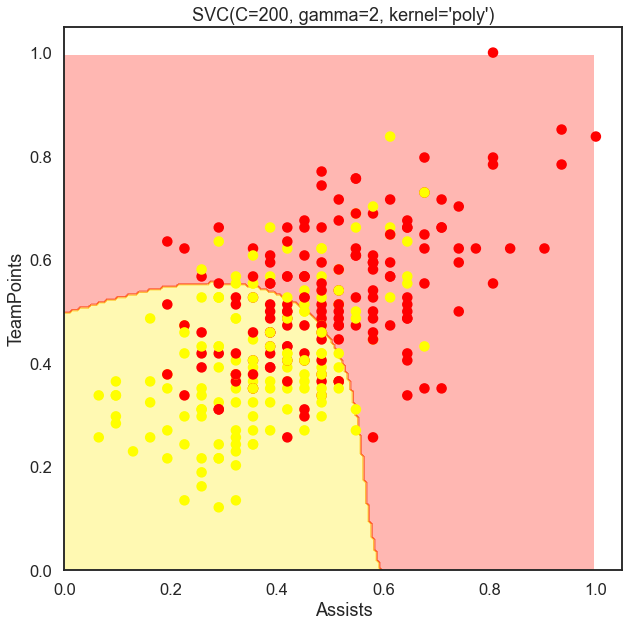

In [19]:
Cs = [10,20,100,200]
for C in Cs:
    SVC_polynomial = SVC(kernel='poly', gamma=2, C=C)
    plot_decision_boundary(SVC_polynomial, X, y)

In [20]:
X.head()

,Assists_scaled,TeamPoints_scaled
0,0.483871,0.459459
1,0.483871,0.459459
2,0.483871,0.324324
3,0.548387,0.689189
4,0.225806,0.472973


In [21]:
y.head()

0    False
1     True
2    False
3    False
4     True
Name: WINorLOSS, dtype: bool

# Training

In [22]:
from sklearn import svm
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)


In [23]:
param_grid = {'C': [.1, 1, 100,1000],
              'gamma': [.5, 1, 2, 10]}

grid = GridSearchCV(SVC(random_state = 42), param_grid = param_grid)

grid = grid.fit(X_train, y_train)

grid.best_estimator_.get_params()

{'C': 1,
 'break_ties': False,
 'cache_size': 200,
 'class_weight': None,
 'coef0': 0.0,
 'decision_function_shape': 'ovr',
 'degree': 3,
 'gamma': 10,
 'kernel': 'rbf',
 'max_iter': -1,
 'probability': False,
 'random_state': 42,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

In [24]:
y_pred = grid.predict(X_test)
y_pred

array([False,  True, False,  True,  True, False,  True, False,  True,
        True, False,  True,  True, False,  True,  True, False,  True,
        True, False, False, False,  True,  True, False, False, False,
        True, False, False,  True,  True, False, False, False, False,
       False,  True, False,  True, False,  True,  True, False,  True,
        True, False,  True,  True,  True,  True,  True,  True, False,
        True, False,  True, False,  True,  True,  True, False,  True,
        True, False,  True, False, False,  True,  True,  True,  True,
        True,  True,  True, False,  True,  True, False,  True,  True,
       False, False,  True,  True, False, False,  True,  True, False,
       False, False,  True, False,  True,  True,  True,  True,  True])

In [25]:
from sklearn.model_selection import cross_validate

cv_results = cross_validate(SVC(), X, y, cv=4)

cv_results

{'fit_time': array([0.0079782 , 0.00598431, 0.00598431, 0.00698161]),
 'score_time': array([0.00299287, 0.00299072, 0.00398993, 0.00299263]),
 'test_score': array([0.70731707, 0.73170732, 0.68292683, 0.73170732])}

# Perform the prediction on the test set

In [26]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
from sklearn.metrics import accuracy_score


print('Accuracy Score : ' + str(accuracy_score(y_test,y_pred)))
print('Precision Score : ' + str(precision_score(y_test,y_pred)))
print('Recall Score : ' + str(recall_score(y_test,y_pred)))
print('F1 Score : ' + str(f1_score(y_test,y_pred)))

Accuracy Score : 0.7575757575757576
Precision Score : 0.7586206896551724
Recall Score : 0.8148148148148148
F1 Score : 0.7857142857142857


# Confusion_matrix

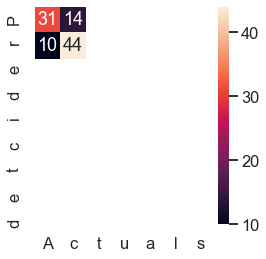

In [27]:
cm = confusion_matrix(y_test, y_pred)
names = np.unique(y_pred)
sns.heatmap(cm, annot = True,fmt = 'd', cbar = True, square = True, xticklabels = 'Actuals', yticklabels = 'Predicted')

# Classification report

In [28]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

       False       0.76      0.69      0.72        45
        True       0.76      0.81      0.79        54

    accuracy                           0.76        99
   macro avg       0.76      0.75      0.75        99
weighted avg       0.76      0.76      0.76        99

